# Import

In [62]:
import json
import itertools

import matplotlib.pyplot as plt
from matplotlib.cm import ScalarMappable
from matplotlib.colors import Normalize
import pandas as pd
import seaborn as sns

from matplotlib import rcParams
rcParams['figure.figsize'] = 8, 8

# Function declaration

In [63]:
def save_fig(fig, name):
    fig.savefig("./graphs/" + name + ".png", format="png")

In [64]:
def fix_status(df_line):
    if df_line.status != "UNKNOWN":
        return df_line.status

    if df_line.objectives != {}:
        return "SATISFIABLE"

    return df_line.status

In [65]:
def get_optimal_solution(df_line):
    if df_line.status != "OPTIMAL_SOLUTION":
        return None

    return min(df_line.objectives.values())

In [66]:
def over_300(row):
    if row.solve_time > 300:
        row.solve_time = 300
        row.objectives = {k : v for k, v in row.objectives.items() if float(k) < 300}
        row.status = "Satisfiable" if len(row.objectives) > 1 else "Unknown"

    return row

In [67]:
def check(x : pd.DataFrame):
    try:
        model1 = x.iloc[0]
        model2 = x.iloc[1]

        status1 = model1.status
        status2 = model2.status

        obj1 = min(model1.objectives.values(), default=None)
        obj2 = min(model2.objectives.values(), default=None)
    except:
        return pd.DataFrame(x).assign(reason="NO CONFRONTATION")

    if status1 == "Optimal solution":
        if status2 == "Optimal solution":
            if obj1 != obj2:
                return x.assign(reason="BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION BUT THE VALUES ARE DIFFERENT")
        elif status2 == "Unsatisfiable":
            return x.assign(reason="ONE SOLVER SAY SAT BUT THE OTHER ONE SAY UNSAT")
    elif status1 == "Unsatisfiable":
        if status2 == "Satisfiable" or status2 == "Optimal solution":
            return x.assign(reason="ONE SOLVER SAY SAT BUT THE OTHER ONE SAY UNSAT")
    elif status1 == "Satisfiable":
        if status2 == "Unsatisfiable":
            return x.assign(reason="ONE SOLVER SAY SAT BUT THE OTHER ONE SAY UNSAT")

In [68]:
def score(t1, t2):
    if t1 == 0 and t2 == 0:
        return (0.5, 0.5)
    else:
        return (
            t2 / (t1 + t2),
            t1 / (t1 + t2),
        )

def solved(x):
    if (
        x.status == "Optimal solution"
        or
        x.status == "Unsatisfiable"
        or
        x.status == "Satisfiable"
    ):
        return True

    return False

def optimal(x):
    return True if x.status == "Optimal solution" else False

def quality(x):
    return min(x.objectives.values(), default=None)

def better(x0, x1):
    q0 = quality(x0)
    q1 = quality(x1)
    if (
        (solved(x0) and not solved(x1))
        or
        (optimal(x0) and not optimal(x1))
        or
        ((q0 < q1) if q0 is not None and q1 is not None else False)
    ):
        return True

    return False

def borda_count(x):
    x0 = x.iloc[0]
    x1 = x.iloc[1]

    b0 = better(x0, x1)
    b1 = better(x1, x0)

    if b0 and not b1:
        return (1, 0)
    elif (b0 and b1) or (not b0 and not b1):
        return score(int(x0.solve_time), int(x1.solve_time))
    else:
        return (0, 1)


In [69]:
def import_df(path) -> pd.DataFrame:
    with open(path, "r") as f:
        results = json.load(f)

    dfs = []
    for k, v in results.items():
        x = pd.DataFrame(v).assign(**{
            "solver" : k
        })

        # Add test features
        test_feature = pd.DataFrame(
            x.problem.apply(lambda s : s.split("/")[-1][:-4].split("_")).tolist(),
            columns=["components", "flavours", "nodes", "resources", "comps_topology", "infra_topology", "test"]
        ).assign(**{
            "components" : lambda df : df.components.apply(lambda x : int(x[1:])),
            "flavours": 1, # lambda df : df.flavours.apply(lambda x : int(x[1:])),
            "nodes" : lambda df : df.nodes.apply(lambda x : int(x[1:])),
            "resources" : 1, # lambda df : df.resources.apply(lambda x : int(x[1:])),
            "comps_topology" : lambda df : df.comps_topology.apply(lambda x : x[1:].upper()),
            "infra_topology" : lambda df : df.infra_topology.apply(lambda x : x[1:].upper()),
            "test" : lambda df : df.test.apply(lambda x : int(x))
        }).assign(**{
            "model": x.problem.apply(lambda s : s.split("/")[-2].upper()).tolist(),
        })

        dfs.append(
            pd.merge(
                left=x,
                right=test_feature,
                right_index=True,
                left_index=True,
            )
        )

    return (
        pd.concat(dfs)
        .rename(columns={"model_y" : "model"})
        .assign(**{
            # Corrections for unkown status codes
            "solve_time" : lambda df : df.apply(
                lambda x :
                    300
                    if "UNKNOWN" in x["status"]
                    else x.solve_time,
                axis=1),
            "status" : lambda df : df.apply(
                lambda x : fix_status(x),
            axis=1),
        })
        .replace({ # Rename some stuff
            "cpsatlp": "OR-Tools",
            "gecode": "Gecode",
            "highs": "Highs",
            "chuffed": "Chuffed",
            "BARABASI": "small-world",
            "ERDOS": "random",
            "LADDER": "ladder",
            "WHEEL": "wheel",
            "PATH": "pipeline",
            "COMPLETE": "complete",
            "SATISFIABLE": "Satisfiable",
            "OPTIMAL_SOLUTION": "Optimal solution",
            "UNSATISFIABLE": "Unsatisfiable",
            "UNKNOWN": "Unknown",
            "ZEPHYRUS": "Zephyrus"
        })
        .assign(optimal_solution=lambda df : df.apply(
            lambda x : min(x.objectives.values()) if "Optimal solution" in x.status else None, axis=1
        ))
        .drop(columns=["problem"])
        .apply(over_300, axis=1)
        .reset_index(drop=True)
    )

In [70]:
def get_to_rerun_df(df, combinations):
    # Get instances were status is discordant or it is not run by all solvers
    indexes = set(df.set_index(["components", "nodes", "comps_topology", "test", "model", "solver"]).index)

    to_rerun = pd.DataFrame(
        data=combinations - indexes,
        columns=["components", "nodes", "comps_topology", "test", "model", "solver"]
    )
    to_rerun.drop_duplicates()

    check = (
        df
        .reset_index()
        .rename(columns={"index": "drop_index"})
        .drop(columns=["flavours", "resources", "flat_time", "solve_time", "infra_topology", "objectives"])
        .groupby(["components", "nodes", "comps_topology", "test"])
    )

    status_discordant = []
    not_all_solvers = []
    for _, group in check:
        if len(group) != 6: # 6 = 3 solvers x 2 models
            not_all_solvers.append(group)
            continue

        a = group.status.value_counts().reset_index()
        if len(a.query("status == 'Unsatisfiable'")) > 0 and len(a.query("status != 'Unsatisfiable'")) > 0:
                status_discordant.append(group)

    to_rerun = pd.concat([
        to_rerun,
        pd.concat(not_all_solvers).drop_duplicates() if len(not_all_solvers) > 0 else pd.DataFrame()
    ], axis=1)

    to_rerun = pd.concat([
        to_rerun,
        pd.concat(status_discordant).drop_duplicates() if len(status_discordant) > 0 else pd.DataFrame()
    ], axis=1)

    return to_rerun

# DataFrame import

In [71]:
component_topologies = ['small-world', 'random', 'pipeline']
solvers = ['Chuffed', 'Highs', 'OR-Tools']
models = ['FREEDA', 'Zephyrus']

In [72]:
combinations = set(itertools.product(
    range(4, 32 + 1), #components
    range(3, 32 + 1), #nodes
    component_topologies,
    range(0, 3), #tests
    models,
    solvers
))
len(combinations)

46980

In [73]:
color = {
    "Chuffed" : "red",
    "OR-Tools": "orange",
    "Gecode" : "#1f77b4",
    "Highs" : "green"
}

marker = {
    "Chuffed" : ".",
    "OR-Tools": "+",
    "Gecode" : "x",
    "Highs" : "2"
}

marker_model = {
    "FREEDA": "*",
    "Zephyrus": "x"
}

color_model = {
    "FREEDA": "#1f77b4",
    "Zephyrus": "red"
}

In [74]:
df = (
    import_df("results/3-results-32x32.json")
    .query("solver != 'Gecode'")
)

In [75]:
df

,status,flat_time,solve_time,objectives,flatzinc_vars,solver,components,flavours,nodes,resources,comps_topology,infra_topology,test,model,optimal_solution
15657,Optimal solution,0.633,0.658,"{'0.656': 8, '0.657': 2, '0.658': 1}",47,Chuffed,4,1,3,1,small-world,complete,0,FREEDA,1.0
15658,Optimal solution,0.619,0.647,{'0.647': 2},47,Chuffed,4,1,3,1,small-world,complete,1,FREEDA,2.0
15659,Optimal solution,0.692,0.726,"{'0.725': 17, '0.726': 4}",38,Chuffed,4,1,3,1,small-world,complete,2,FREEDA,4.0
15660,Optimal solution,0.162,0.182,"{'0.18': 8, '0.181': 3, '0.182': 1}",70,Chuffed,4,1,3,1,small-world,complete,0,Zephyrus,1.0
15661,Optimal solution,0.161,0.182,"{'0.18': 8, '0.181': 3, '0.182': 2}",176,Chuffed,4,1,3,1,small-world,complete,1,Zephyrus,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
62632,Optimal solution,0.608,0.658,"{'0.65': 4, '0.652': 2, '0.655': 1}",232,OR-Tools,8,1,17,1,pipeline,complete,1,FREEDA,1.0
62633,Optimal solution,0.647,0.698,"{'0.688': 4, '0.69': 3, '0.693': 2, '0.695': 1}",232,OR-Tools,8,1,17,1,pipeline,complete,2,FREEDA,1.0
62634,Optimal solution,0.267,0.358,"{'0.343': 7, '0.347': 6, '0.351': 3, '0.354': 2}",622,OR-Tools,8,1,17,1,pipeline,complete,0,Zephyrus,2.0
62635,Optimal solution,0.263,0.357,"{'0.339': 8, '0.343': 5, '0.346': 3, '0.35': 2...",622,OR-Tools,8,1,17,1,pipeline,complete,1,Zephyrus,1.0


In [76]:
# Istances where solvers are bugged
df_model_solver = df.assign(**{
    "model_solver": lambda df : df.apply(lambda x : x.model + "_" + x.solver, axis=1)
}).drop(columns=["flavours", "resources", "flat_time", "infra_topology"])

models_solvers = itertools.combinations([m + "_" + s for m, s in itertools.product(models, solvers)], r=2)

errors = []
for model_solver1, model_solver2 in models_solvers:
    to_group = df_model_solver.query("model_solver == @model_solver1 or model_solver == @model_solver2")
    for _, group in to_group.groupby(["components", "nodes", "comps_topology", "test"]):
        a = check(group)
        if a is not None:
            errors.append(a)

In [77]:
if len(errors) > 0:
    error_optimal_obj_discordant = (
        pd.concat(errors)
        .drop(columns=["objectives"])
        .drop_duplicates()
        .query("reason == 'BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION BUT THE VALUES ARE DIFFERENT'")
        .groupby(["components", "nodes", "comps_topology", "test"])
    )

    for _, g in error_optimal_obj_discordant:
        optimals = g.groupby("model").aggregate({"optimal_solution": set})
        freeda_optimals = optimals.loc["FREEDA"]["optimal_solution"]
        zephyrus_optimals = optimals.loc["Zephyrus"]["optimal_solution"]
        if len(freeda_optimals) != 1:
            print("MORE SOLUTIONS IN FREEDA")
        if len(zephyrus_optimals) != 1:
            print("MORE SOLUTIONS IN ZEPHYRUS")

        values = g[["solver", "model", "optimal_solution"]].set_index(["solver", "model"]).unstack().nunique().sum()

        if values > 2:
            print("SOME MODEL-SOLVER COMBINATION PRESENT MORE THAN A SOLUTION")
else:
    print("NO ERRORS")

NO ERRORS


In [78]:
df.solver.unique()

array(['Chuffed', 'Highs', 'OR-Tools'], dtype=object)

In [79]:
len(combinations)

46980

# Clean up

In [80]:
df.groupby(["components", "nodes", "comps_topology", "test"]).count()

status  flat_time  solve_time  \
components nodes comps_topology test                                  
4          3     pipeline       0          6          6           6   
                                1          6          6           6   
                                2          6          6           6   
                 random         0          6          6           6   
                                1          6          6           6   
...                                      ...        ...         ...   
32         32    random         1          6          6           6   
                                2          6          6           6   
                 small-world    0          6          6           6   
                                1          6          6           6   
                                2          6          6           6   

                                      objectives  flatzinc_vars  solver  \
components nodes comps_topology test                                      
4          3     pipeline       0              6              6       6   
                                1              6              6       6   
                                2              6              6       6   
                 random         0              6              6       6   
                                1              6              6       6   
...                                          ...            ...     ...   
32         32    random         1              6              6       6   
                                2              6              6       6   
                 small-world    0              6              6       6   
                                1              6              6       6   
                                2              6              6       6   

                                      flavours  resources  infra_topology  \
components nodes comps_topology test                                        
4          3     pipeline       0            6          6               6   
                                1            6          6               6   
                                2            6          6               6   
                 random         0            6          6               6   
                                1            6          6               6   
...                                        ...        ...             ...   
32         32    random         1            6          6               6   
                                2            6          6               6   
                 small-world    0            6          6               6   
                                1            6          6               6   
                                2            6          6               6   

                                      model  optimal_solution  
components nodes comps_topology test                           
4          3     pipeline       0         6                 6  
                                1         6                 6  
                                2         6                 6  
                 random         0         6                 6  
                                1         6                 6  
...                                     ...               ...  
32         32    random         1         6                 4  
                                2         6                 4  
                 small-world    0         6                 5  
                                1         6                 4  
                                2         6                 6  

[7830 rows x 11 columns]

In [81]:
df.query("solve_time > 300")

,status,flat_time,solve_time,objectives,flatzinc_vars,solver,components,flavours,nodes,resources,comps_topology,infra_topology,test,model,optimal_solution


# DataFrame Analysis

In [82]:
df.status.unique()

array(['Optimal solution', 'Unknown', 'Satisfiable'], dtype=object)

In [83]:
df.status.value_counts(normalize=True)

status
Optimal solution    0.985590
Unknown             0.014070
Satisfiable         0.000341
Name: proportion, dtype: float64

In [84]:
df[["components", "status"]].groupby("components").value_counts()

components  status          
4           Optimal solution    1620
5           Optimal solution    1620
6           Optimal solution    1620
7           Optimal solution    1620
8           Optimal solution    1620
9           Optimal solution    1620
10          Optimal solution    1620
11          Optimal solution    1620
12          Optimal solution    1620
13          Optimal solution    1620
14          Optimal solution    1620
15          Optimal solution    1620
16          Optimal solution    1620
17          Optimal solution    1620
18          Optimal solution    1620
19          Optimal solution    1618
            Unknown                2
20          Optimal solution    1614
            Unknown                6
21          Optimal solution    1614
            Unknown                6
22          Optimal solution    1615
            Unknown                5
23          Optimal solution    1611
            Unknown                8
            Satisfiable            1
24       

In [85]:
df[["nodes", "status"]].groupby("nodes").value_counts()

nodes  status          
3      Optimal solution    1554
       Unknown               12
4      Optimal solution    1543
       Unknown               23
5      Optimal solution    1547
                           ... 
31     Optimal solution    1545
       Unknown               20
       Satisfiable            1
32     Optimal solution    1541
       Unknown               25
Name: count, Length: 72, dtype: int64

In [86]:
pd.concat(
    [
        df[["components", "nodes", "status"]].groupby(["components", "nodes"]).value_counts(),
        df[["components", "nodes", "status"]].groupby(["components", "nodes"]).value_counts(normalize=True) * 100
    ],
    axis=1,
    keys=['counts', '%']
).reset_index()#.to_csv("./status_aggregated.csv", index=False)

,components,nodes,status,counts,%
0,4,3,Optimal solution,54,100.000000
1,4,4,Optimal solution,54,100.000000
2,4,5,Optimal solution,54,100.000000
3,4,6,Optimal solution,54,100.000000
4,4,7,Optimal solution,54,100.000000
...,...,...,...,...,...
1107,32,31,Optimal solution,48,88.888889
1108,32,31,Unknown,5,9.259259
1109,32,31,Satisfiable,1,1.851852
1110,32,32,Optimal solution,45,83.333333


<Axes: title={'center': 'Distribution of solve_time'}>

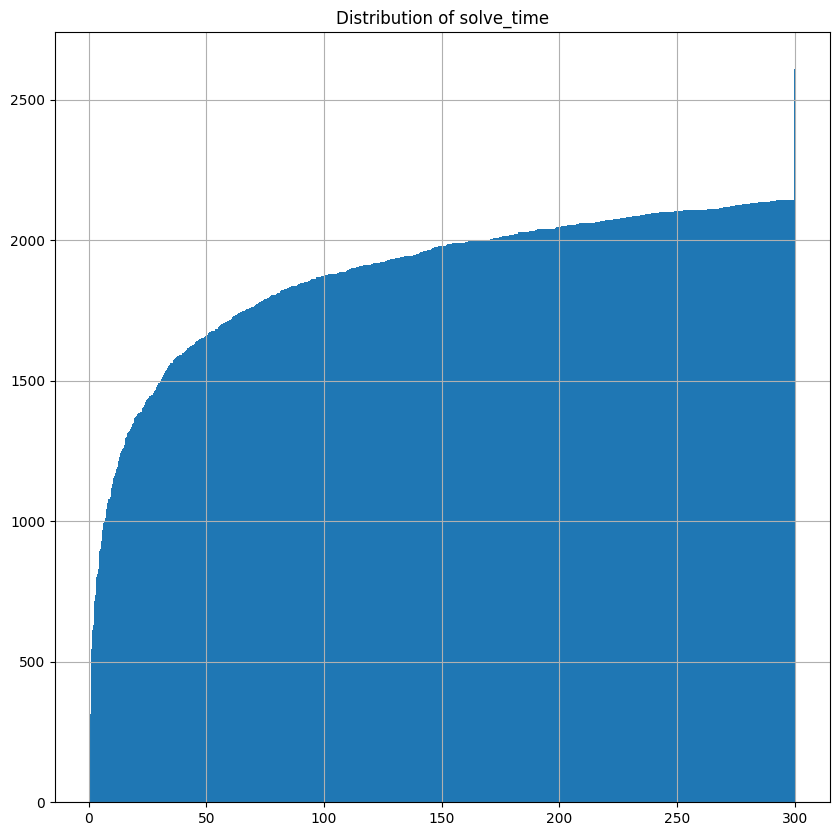

In [87]:
plt.figure(figsize=(10, 10))
plt.title("Distribution of solve_time")
vbs = df.sort_values("solve_time", ascending=False).groupby(["components", "nodes", "test"]).head(1)
vbs.solve_time.sort_values().hist(bins=1000, cumulative=True)

<Axes: title={'center': 'Distribution only for Optimal solutions'}>

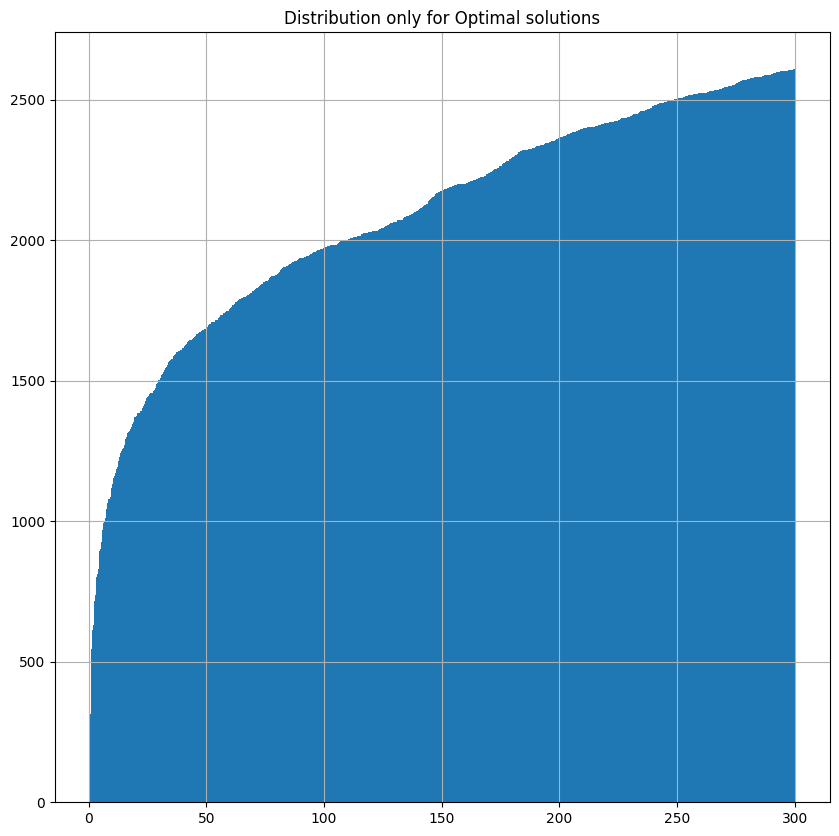

In [88]:
plt.figure(figsize=(10, 10))
plt.title("Distribution only for Optimal solutions")
vbs = df.query("status == 'Optimal solution'").sort_values("solve_time", ascending=False).groupby(["components", "nodes", "test"]).head(1)
vbs.solve_time.sort_values().hist(bins=1000, cumulative=True)

# Solve Time

### Components

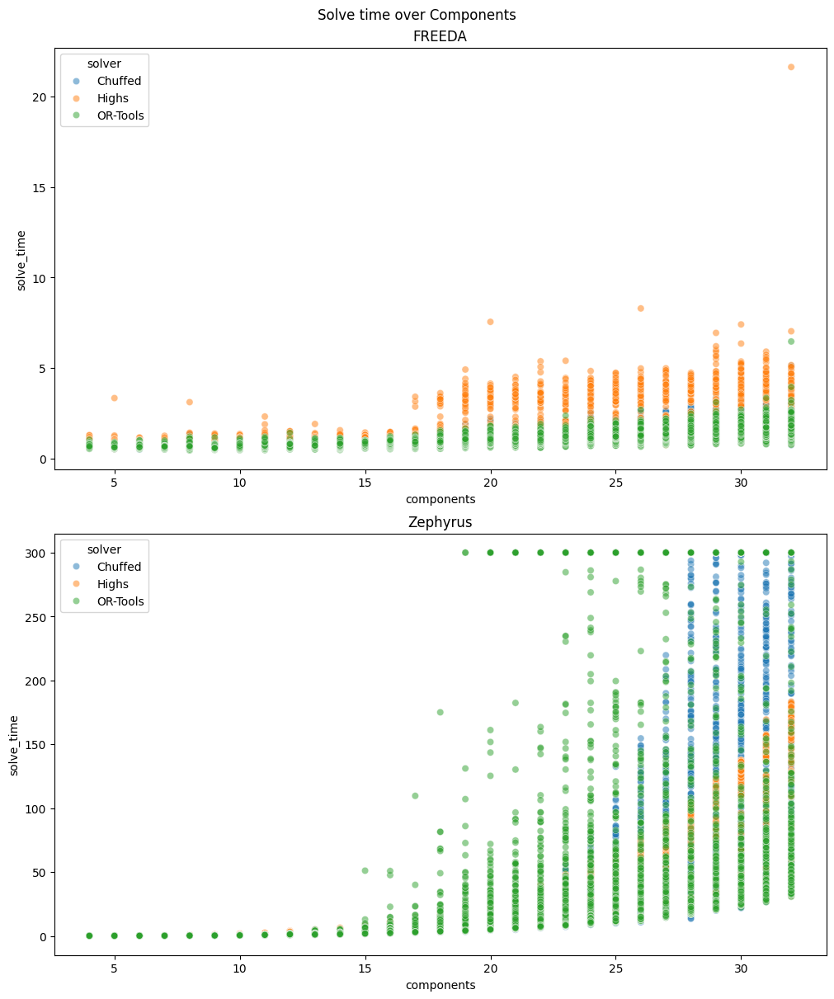

In [89]:
fig, axs = plt.subplots(len(models), 1, constrained_layout=True)
fig.suptitle("Solve time over Components")
fig.set_figheight(6 * len(models))
fig.set_figwidth(10)
for m, ax in zip(models, axs):
    ax.set_title(str(m))
    sns.scatterplot(
        data=df.query("model == @m"),
        x="components",
        y="solve_time",
        alpha=0.5,
        hue="solver",
        ax=ax
    )

### Nodes

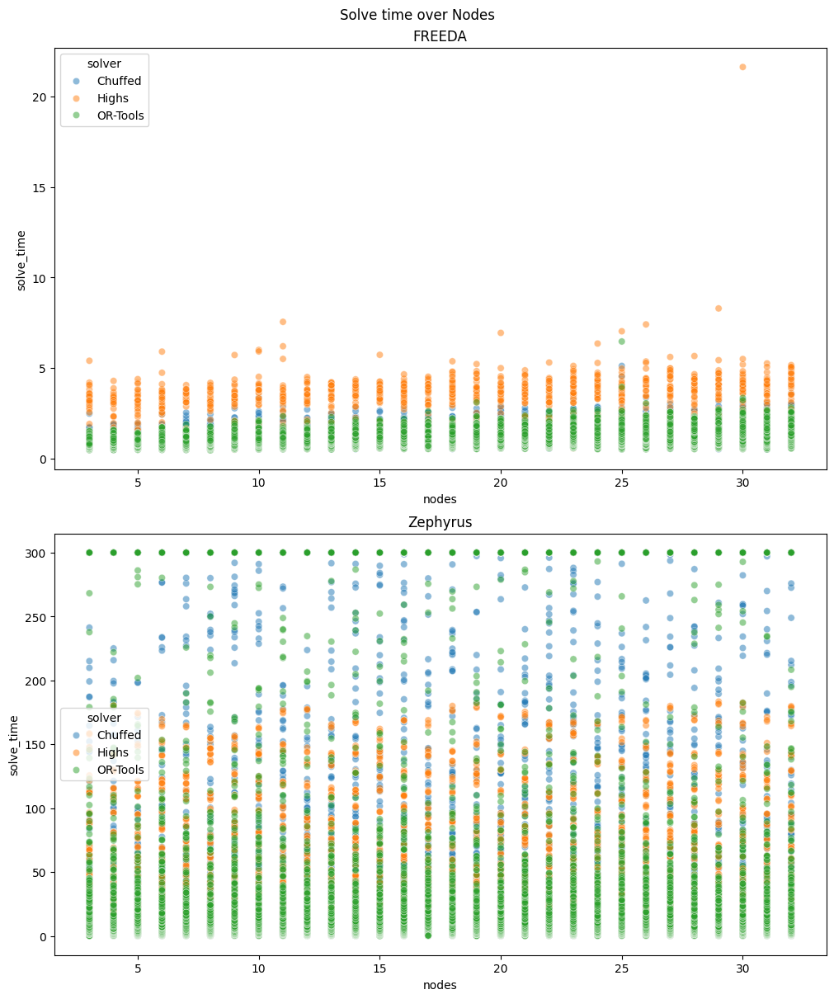

In [90]:
fig, axs = plt.subplots(len(models), 1, constrained_layout=True)
fig.suptitle("Solve time over Nodes")
fig.set_figheight(6 * len(models))
fig.set_figwidth(10)
for m, ax in zip(models, axs):
    ax.set_title(str(m))
    sns.scatterplot(
        data=df.query("model == @m"),
        x="nodes",
        y="solve_time",
        alpha=0.5,
        hue="solver",
        ax=ax
    )

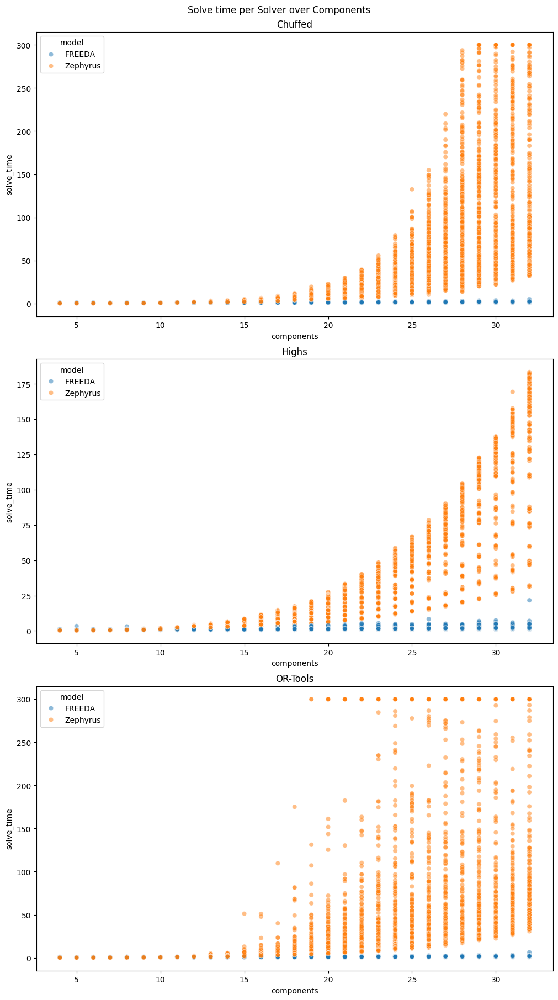

In [91]:
fig, axs = plt.subplots(len(solvers), 1, constrained_layout=True)
fig.suptitle("Solve time per Solver over Components")
fig.set_figheight(6 * len(solvers))
fig.set_figwidth(10)
for s, ax in zip(solvers, axs):
    ax.set_title(str(s))
    sns.scatterplot(
        data=df.query("solver == @s"),
        x="components",
        y="solve_time",
        alpha=0.5,
        hue="model",
        ax=ax
    )

### Components x nodes

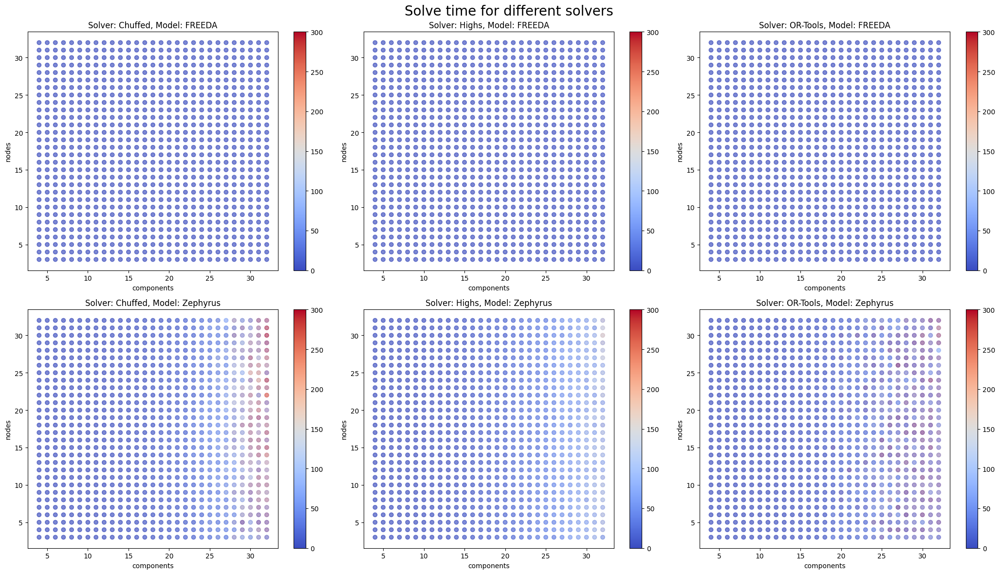

In [92]:
fig, axs = plt.subplots(
    nrows=len(models),
    ncols=len(solvers),
    figsize=(7 * len(solvers), 6 * len(models))
)
norm = Normalize(vmin=0, vmax=df.solve_time.max())
for m, ax_row in zip(models, axs):
    for s, ax in zip(solvers, ax_row):
        d = df.query("model == @m").query("solver == @s")
        ax.scatter(
            x=d.components,
            y=d.nodes,
            c=d.solve_time,
            cmap="coolwarm",
            norm=norm,
            alpha=1.0/(len(component_topologies) * 3)
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_title("Solver: " + s + ", Model: " + m)
        fig.colorbar(ScalarMappable(norm=norm, cmap="coolwarm"), ax=ax, orientation='vertical')

fig.suptitle("Solve time for different solvers", fontsize=20)
fig.tight_layout()

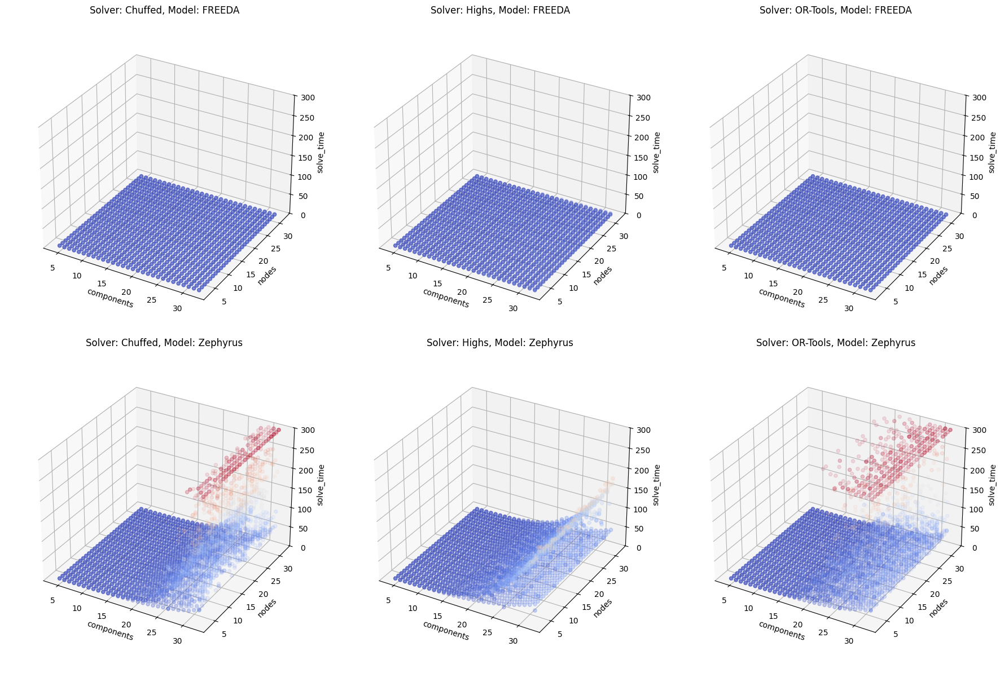

In [93]:
fig, axs = plt.subplots(
    nrows=len(models),
    ncols=len(solvers),
    figsize=(6 * len(solvers), 6 * len(models)),
    subplot_kw=dict(projection='3d')
)
norm = Normalize(vmin=0, vmax=df.solve_time.max())
for m, ax_row in zip(models, axs):
    for s, ax in zip(solvers, ax_row):
        d = df.query("model == @m").query("solver == @s")
        ax.scatter(
            xs=d.components,
            ys=d.nodes,
            zs=d.solve_time,
            c=d.solve_time,
            cmap="coolwarm",
            norm=norm,
            alpha=1.0/(len(component_topologies) * 3)
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_zlabel("solve_time")
        ax.set_title("Solver: " + s + ", Model: " + m)
        ax.set_box_aspect(None, zoom=0.90)
        ax.set_zlim([0, 300])

fig.tight_layout()

### Topologies

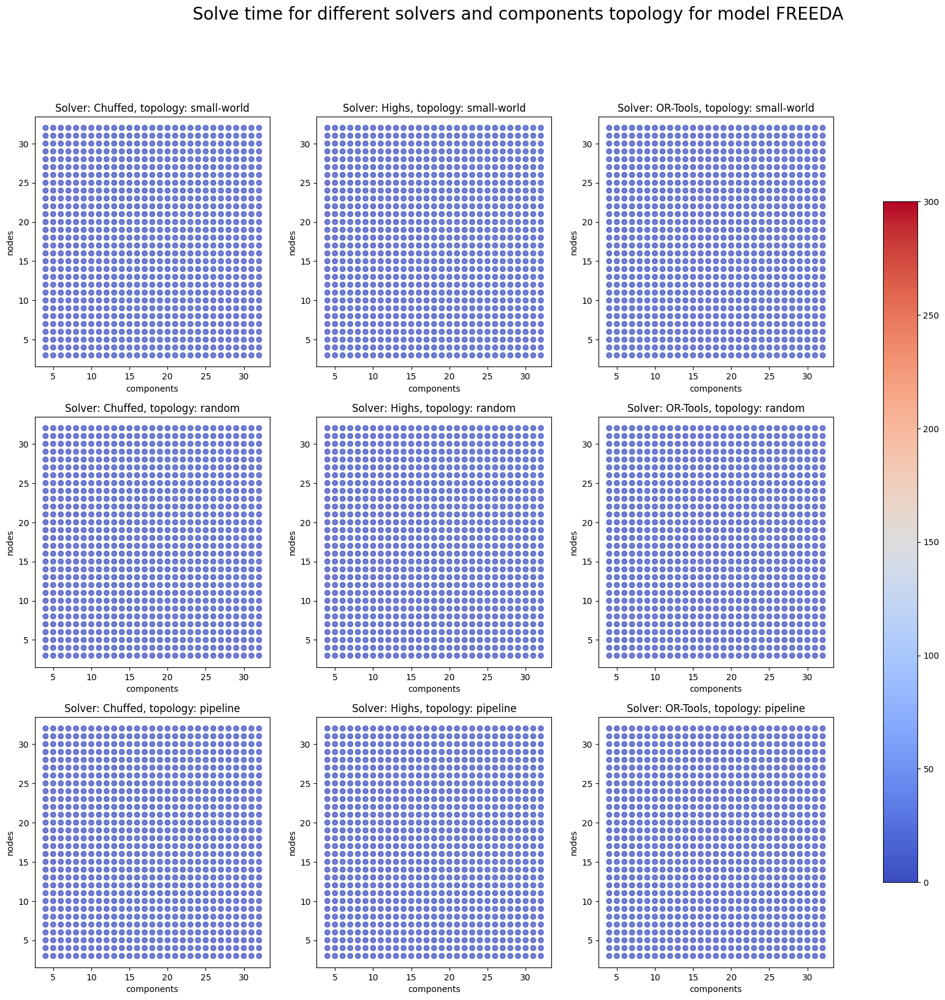

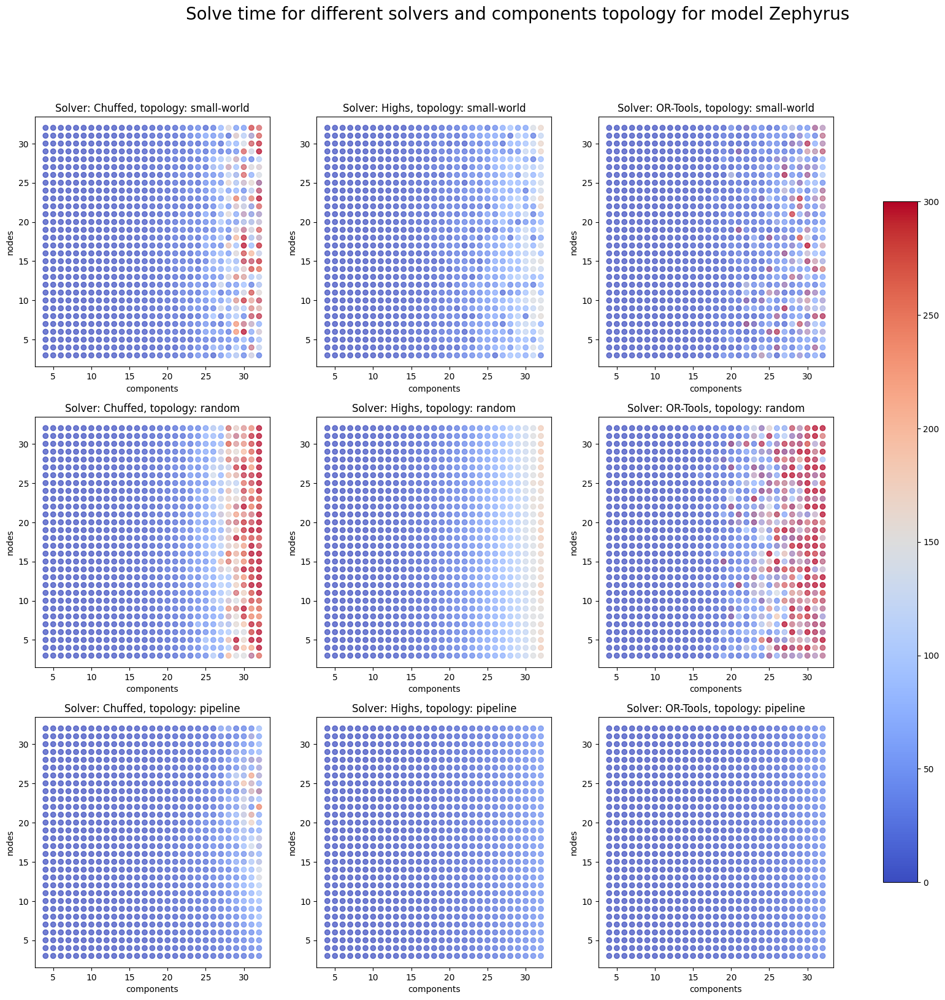

In [94]:
norm = Normalize(vmin=0, vmax=300)
for m in models:
    fig, axs = plt.subplots(
        nrows=len(component_topologies),
        ncols=len(solvers),
        figsize=(7 * len(component_topologies), 6 * len(solvers))
    )
    axs_reshaped = axs.reshape(-1)
    axis = itertools.product(component_topologies, solvers)
    df_model = df.query("model == @m")
    for (topology, solver), ax in zip(axis, axs_reshaped):
        d = df_model.query("solver == @solver").query("comps_topology == @topology")
        ax.scatter(
            x=d.components,
            y=d.nodes,
            c=d.solve_time,
            cmap="coolwarm",
            norm=norm,
            alpha=1.0/3
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_title("Solver: " + solver + ", topology: " + topology)

    fig.suptitle("Solve time for different solvers and components topology for model " + m, fontsize=20)
    fig.colorbar(
        ScalarMappable(norm=norm, cmap="coolwarm"),
        ax=axs.ravel().tolist(),
        orientation='vertical',
        shrink=0.8
    )

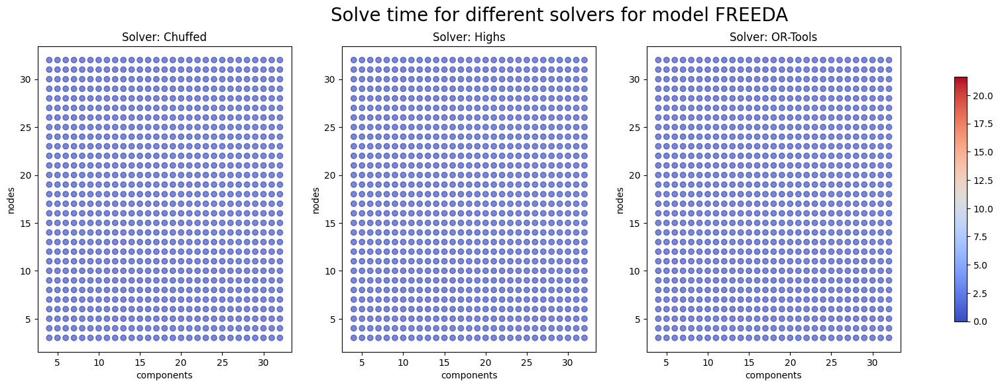

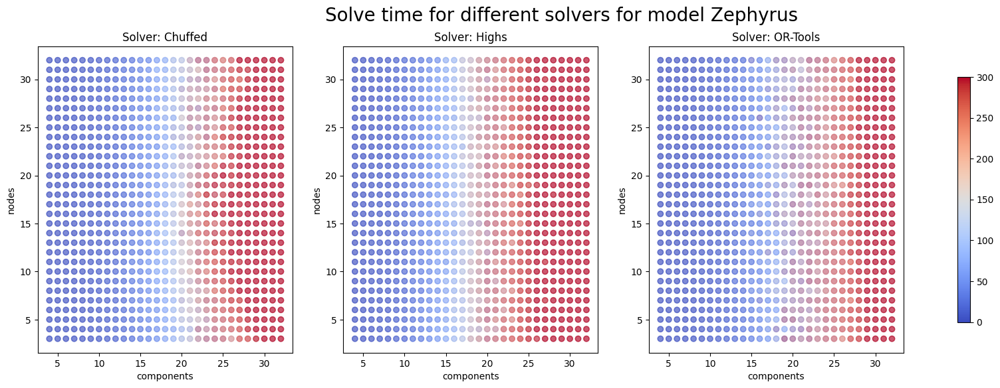

In [95]:
for m in models:
    fig, axs = plt.subplots(
        nrows=1,
        ncols=len(solvers),
        figsize=(7 * len(solvers), 6)
    )
    axs_reshaped = axs.reshape(-1)
    df_model = df.query("model == @m")
    for solver, ax in zip(solvers, axs_reshaped):
        d = df_model.query("solver == @solver")
        ax.scatter(
            x=d.components,
            y=d.nodes,
            c=d.solve_time,
            cmap="coolwarm",
            norm=norm,
            alpha=1.0/(len(component_topologies) * 3)
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_title("Solver: " + solver)

    norm = Normalize(vmin=0, vmax=df_model.solve_time.max())
    fig.colorbar(
        ScalarMappable(norm=norm, cmap="coolwarm"),
        ax=axs.ravel().tolist(),
        orientation='vertical',
        shrink=0.8
    )
    fig.suptitle("Solve time for different solvers for model " + m, fontsize=20)

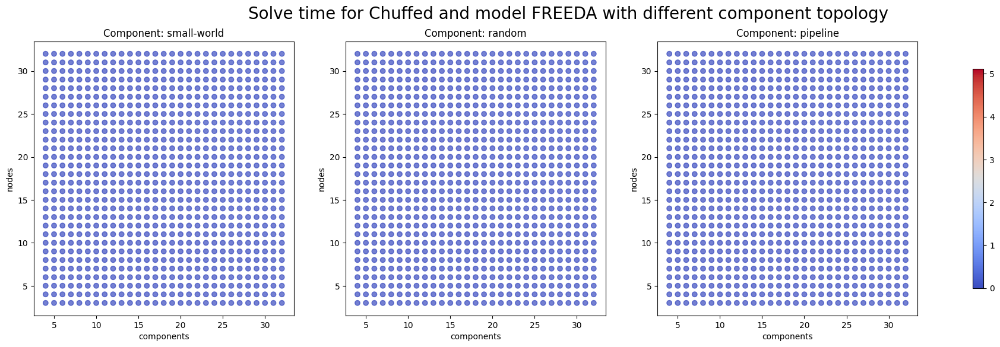

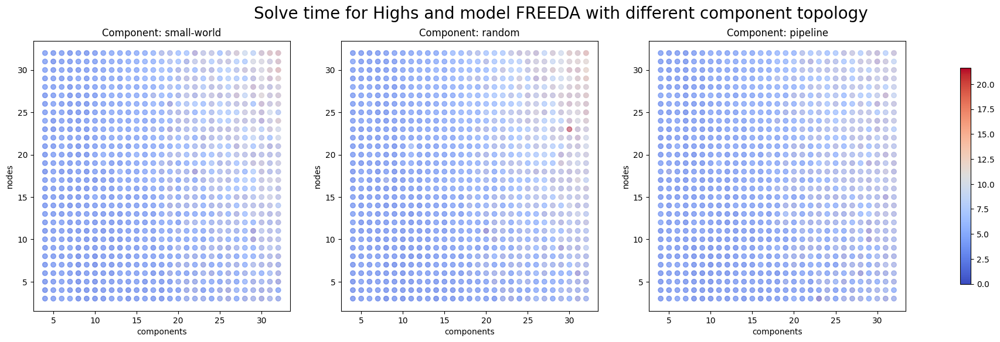

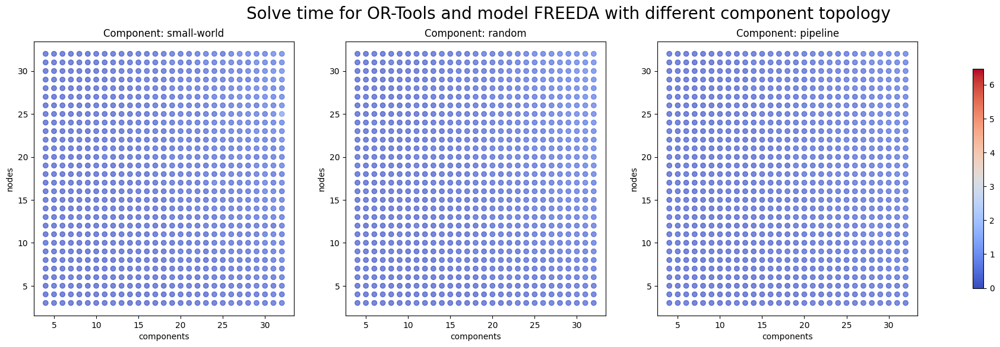

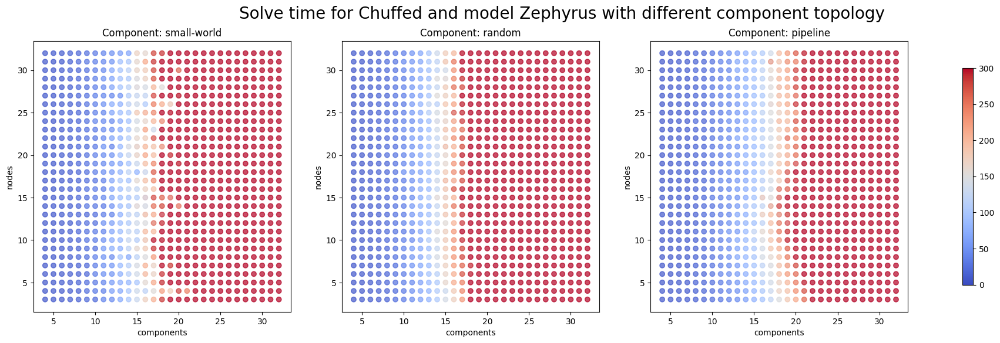

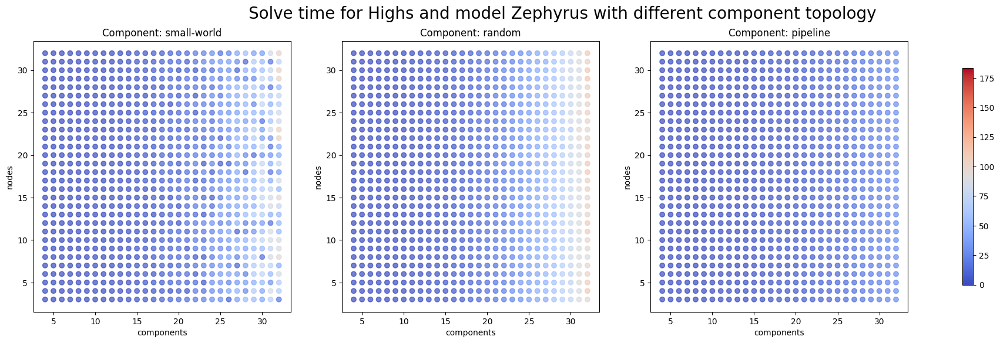

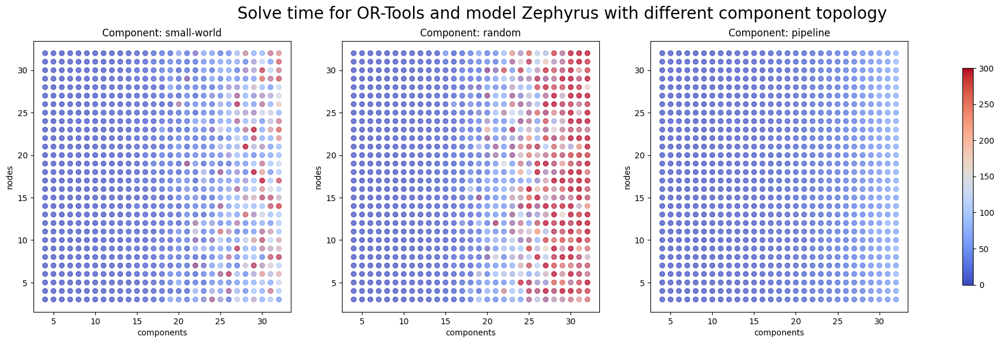

In [96]:
for m in models:
    for solver in solvers:
        fig, axs = plt.subplots(
            nrows=1,
            ncols=len(component_topologies),
            figsize=(8 * len(component_topologies), 6)
        )
        axs_reshaped = axs.reshape(-1)
        df_solver_problem = df.query("model == @m").query("solver == @solver")
        for comps_topology, ax in zip(component_topologies, axs_reshaped):
            d = df_solver_problem.query("comps_topology == @comps_topology")
            ax.scatter(
                x=d.components,
                y=d.nodes,
                c=d.solve_time,
                cmap="coolwarm",
                norm=norm,
                alpha=1.0/3
            )
            ax.set_xlabel("components")
            ax.set_ylabel("nodes")
            ax.set_title("Component: " + comps_topology)

        norm = Normalize(vmin=0, vmax=df_solver_problem.solve_time.max())
        fig.colorbar(
            ScalarMappable(norm=norm, cmap="coolwarm"),
            ax=axs.ravel().tolist(),
            orientation='vertical',
            shrink=0.8
        )
        fig.suptitle("Solve time for " + solver + " and model " + m + " with different component topology", fontsize=20)


# Flat time

### Components

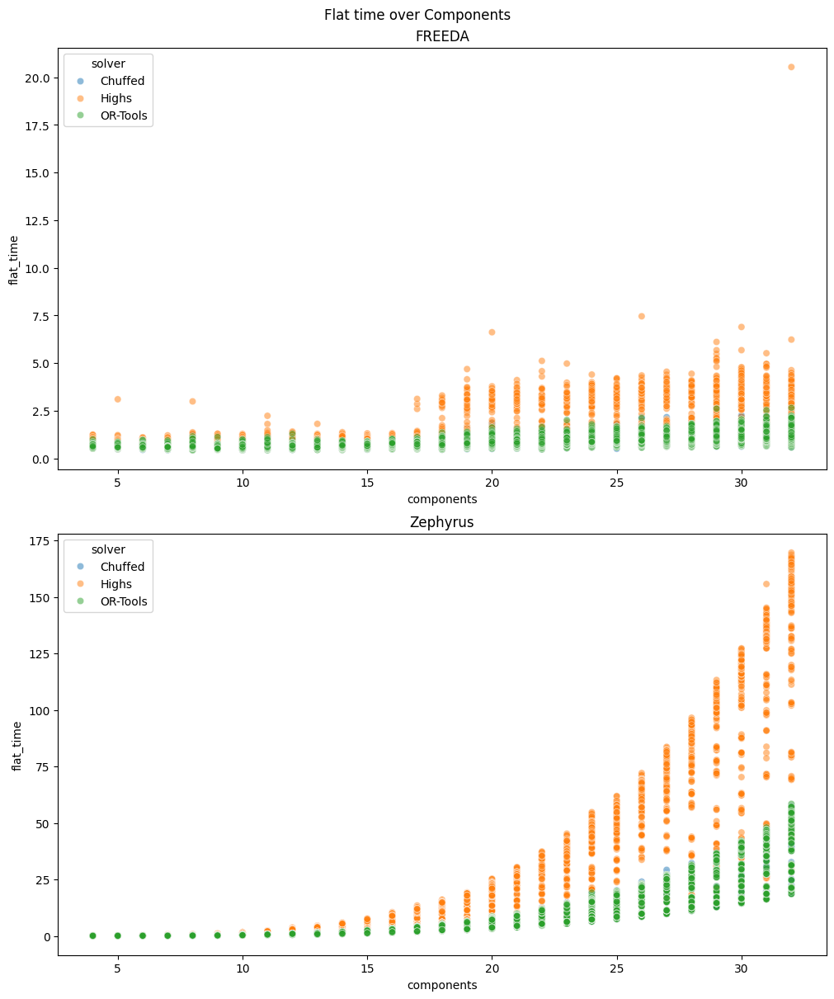

In [97]:
fig, axs = plt.subplots(len(models), 1, constrained_layout=True)
fig.suptitle("Flat time over Components")
fig.set_figheight(6 * len(models))
fig.set_figwidth(10)
for m, ax in zip(models, axs):
    ax.set_title(m)
    sns.scatterplot(
        data=df.query("model == @m"),
        x="components",
        y="flat_time",
        alpha=0.5,
        hue="solver",
        ax=ax
    )

### Nodes

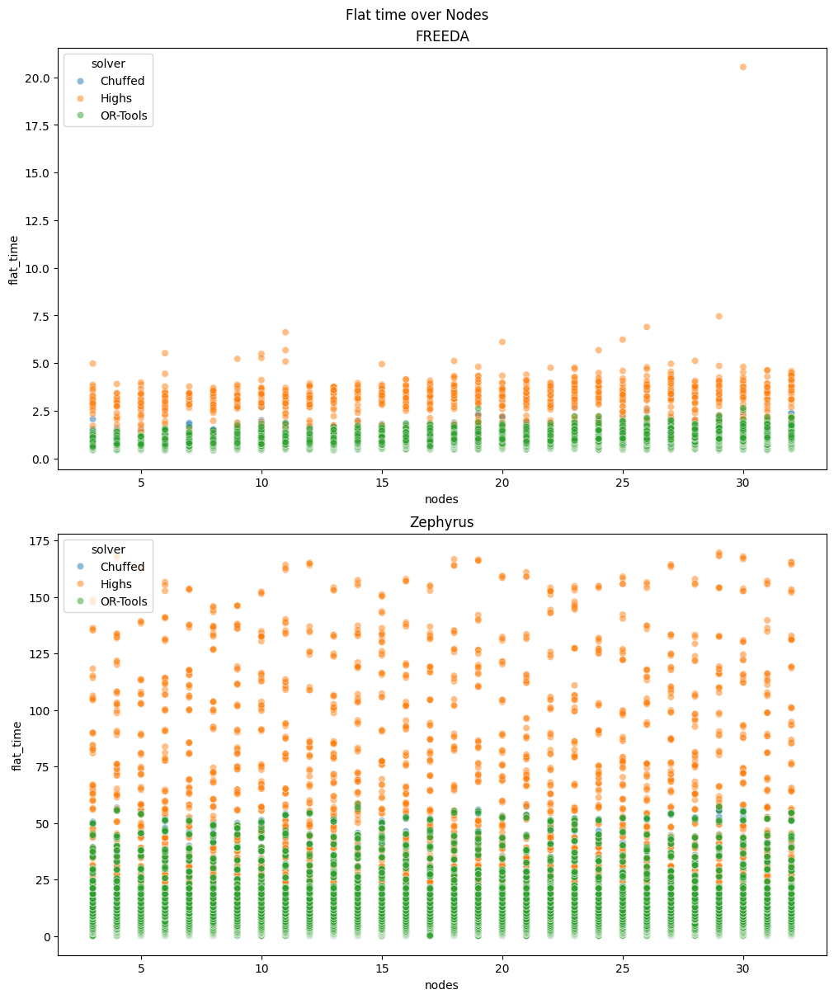

In [98]:
fig, axs = plt.subplots(len(models), 1, constrained_layout=True)
fig.suptitle("Flat time over Nodes")
fig.set_figheight(6 * len(models))
fig.set_figwidth(10)
for m, ax in zip(models, axs):
    ax.set_title(m)
    sns.scatterplot(
        data=df.query("model == @m"),
        x="nodes",
        y="flat_time",
        alpha=0.5,
        hue="solver",
        ax=ax
    )

### Components x nodes

Text(0.5, 0.98, 'Flat time for different solvers')

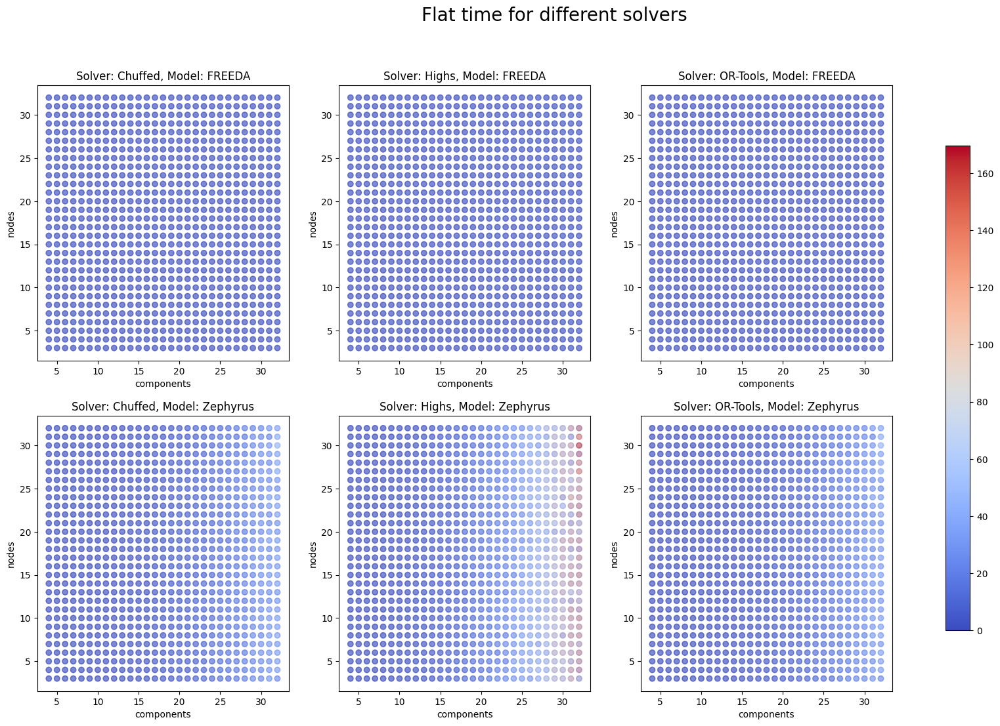

In [99]:
fig, axs = plt.subplots(
    nrows=len(models),
    ncols=len(solvers),
    figsize=(7 * len(solvers), 6 * len(models))
)
norm = Normalize(vmin=0, vmax=df.flat_time.max())
for m, ax_row in zip(models, axs):
    for s, ax in zip(solvers, ax_row):
        d = df.query("model == @m").query("solver == @s")
        ax.scatter(
            x=d.components,
            y=d.nodes,
            c=d.flat_time,
            cmap="coolwarm",
            norm=norm,
            alpha=1.0/(len(component_topologies) * 3)
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_title("Solver: " + s + ", Model: " + m)

fig.colorbar(
    ScalarMappable(norm=norm, cmap="coolwarm"),
    ax=axs.ravel().tolist(),
    orientation='vertical',
    shrink=0.8
)
fig.suptitle("Flat time for different solvers", fontsize=20)

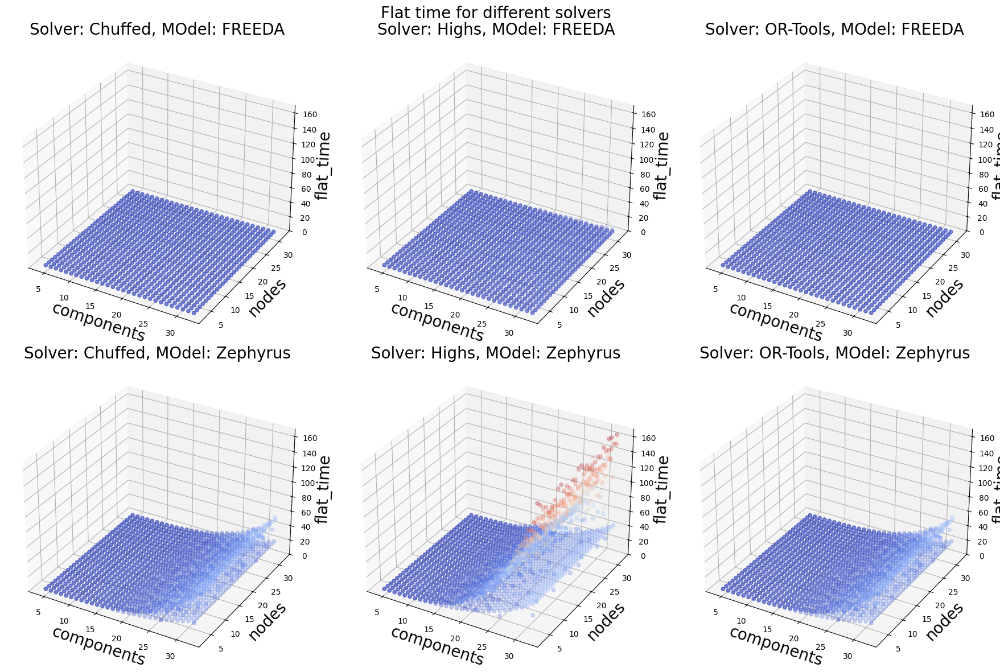

In [100]:
fig, axs = plt.subplots(
    nrows=len(models),
    ncols=len(solvers),
    figsize=(6 * len(solvers), 6 * len(models)),
    subplot_kw=dict(projection='3d')
)
norm = Normalize(vmin=0, vmax=df.flat_time.max())
for m, ax_row in zip(models, axs):
    for s, ax in zip(solvers, ax_row):
        d = df.query("model == @m").query("solver == @s")
        ax.scatter(
            xs=d.components,
            ys=d.nodes,
            zs=d.flat_time,
            c=d.flat_time,
            norm=norm,
            cmap="coolwarm",
            alpha=1.0/(len(component_topologies) * 3)
        )
        ax.set_zlim([0, df.flat_time.max()])
        ax.set_xlabel("components", fontsize=20)
        ax.set_ylabel("nodes", fontsize=20)
        ax.set_zlabel("flat_time", fontsize=20)
        ax.set_title("Solver: " + s + ", MOdel: " + m, fontsize=20)

fig.suptitle("Flat time for different solvers", fontsize=20)
fig.tight_layout()

### Topologies

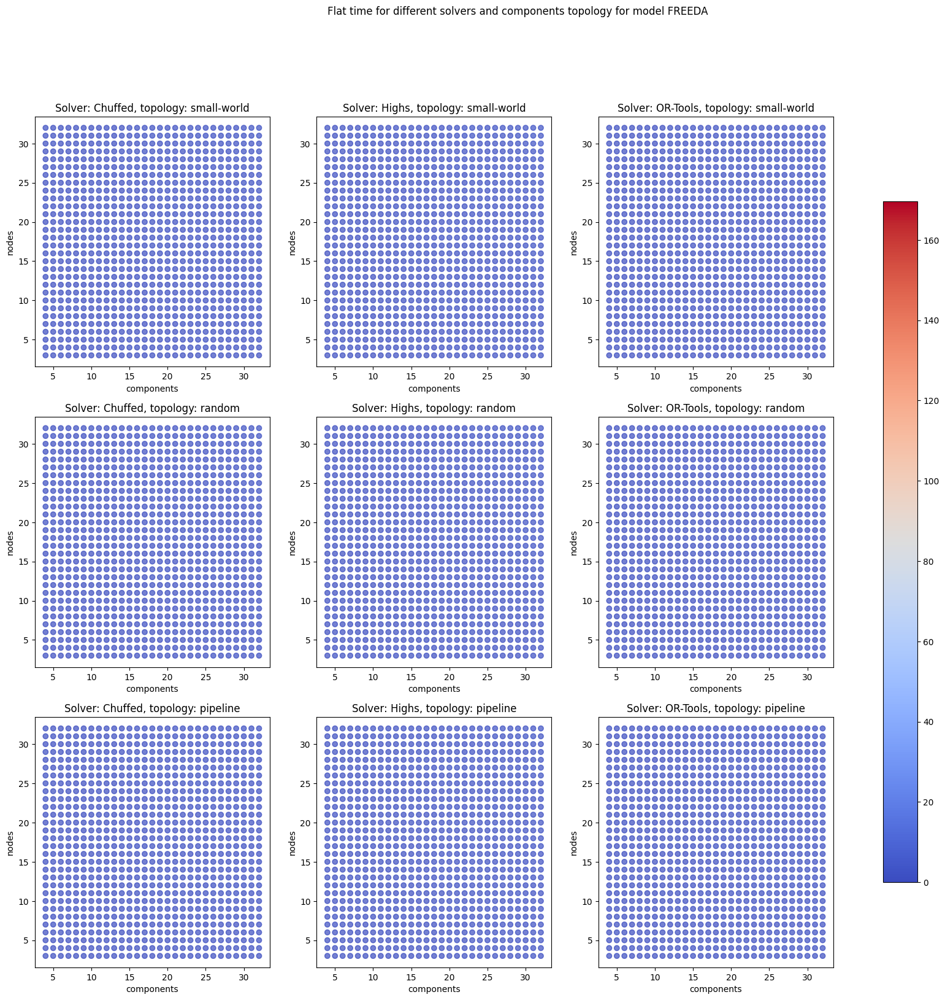

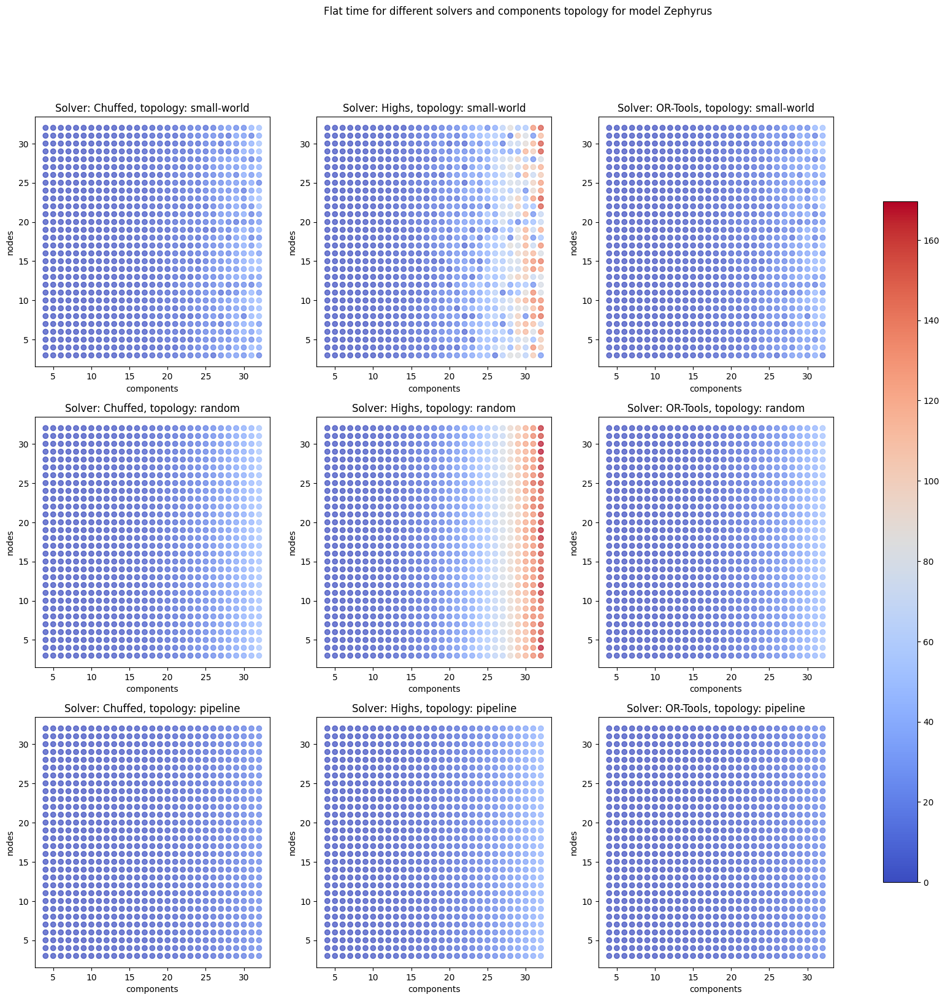

In [101]:
for m in models:
    fig, axs = plt.subplots(
        nrows=len(component_topologies),
        ncols=len(solvers),
        figsize=(7 * len(component_topologies), 6 * len(solvers))
    )
    axs_reshaped = axs.reshape(-1)
    axis = itertools.product(component_topologies, solvers)
    df_problem = df.query("model == @m")
    for (topology, solver), ax in zip(axis, axs_reshaped):
        d = df_problem.query("solver == @solver").query("comps_topology == @topology")
        ax.scatter(
            x=d.components,
            y=d.nodes,
            c=d.flat_time,
            cmap="coolwarm",
            norm=norm,
            alpha=1.0/3
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_title("Solver: " + solver + ", topology: " + topology)

    fig.suptitle("Flat time for different solvers and components topology for model " + m)
    fig.colorbar(
        ScalarMappable(norm=norm, cmap="coolwarm"),
        ax=axs.ravel().tolist(),
        orientation='vertical',
        shrink=0.8
    )

# Flat time vs Solve time

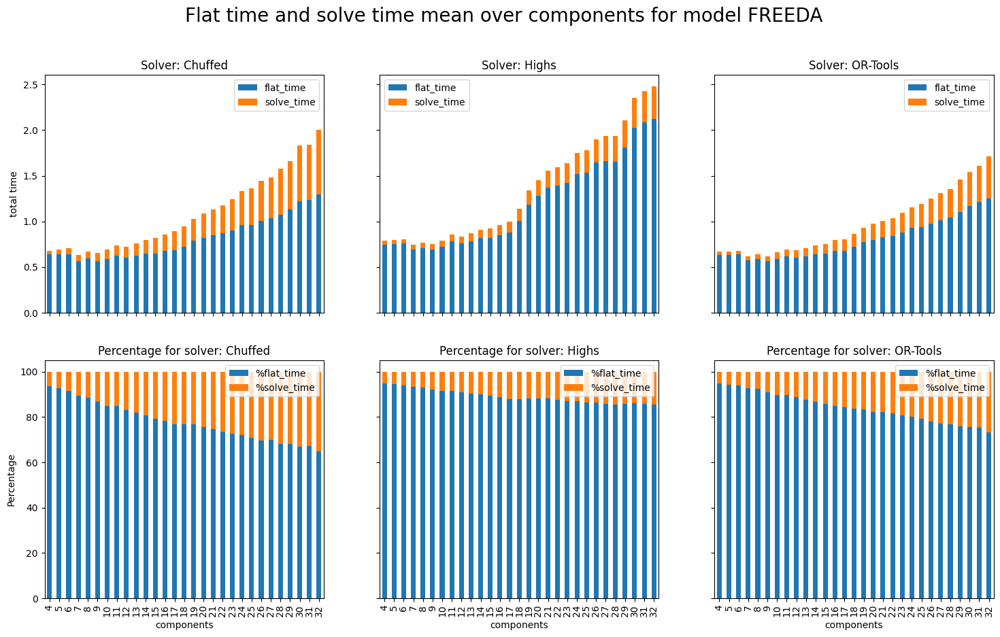

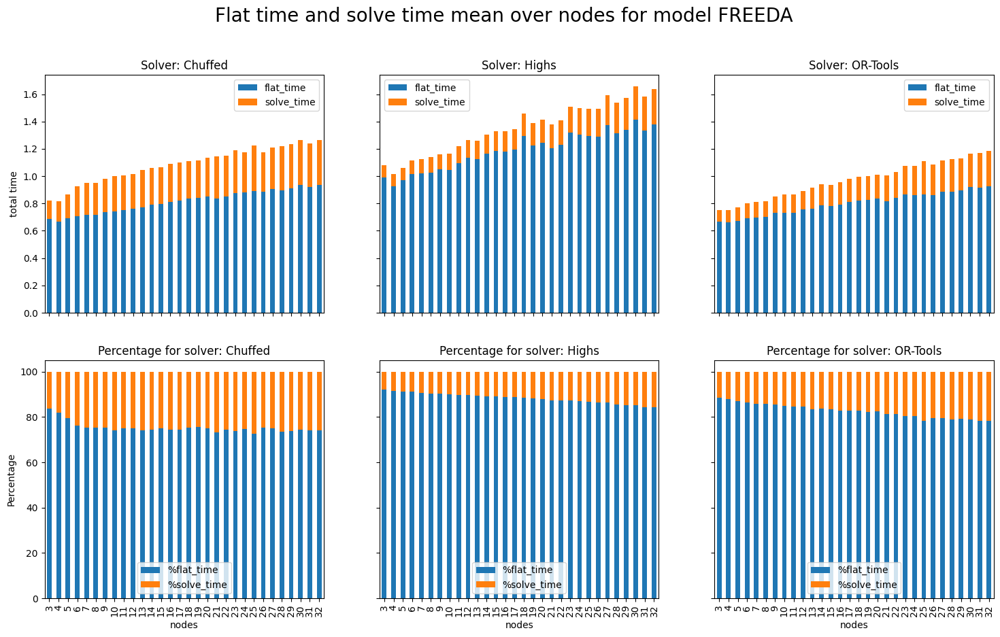

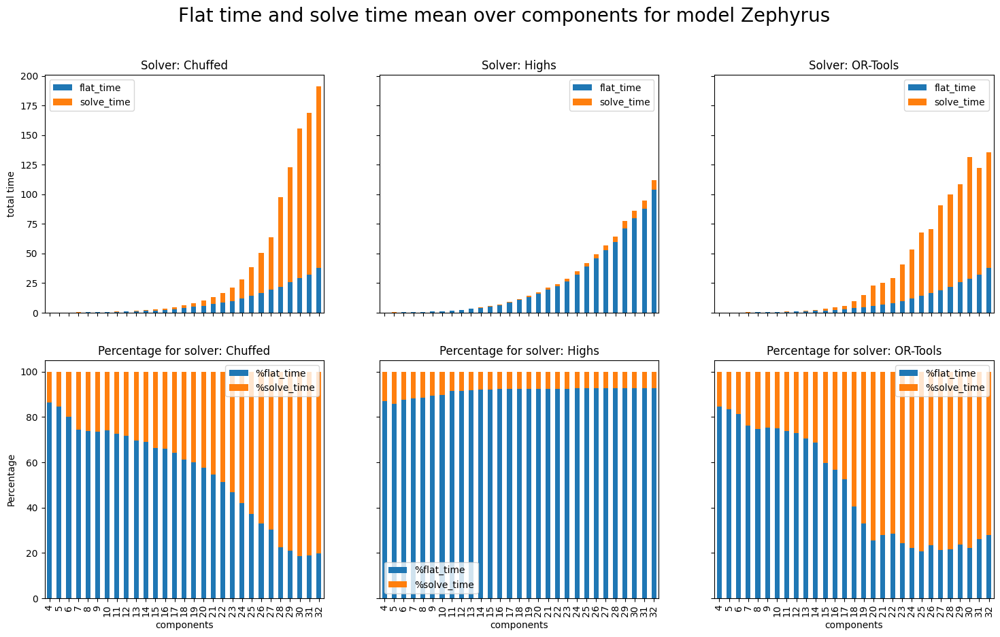

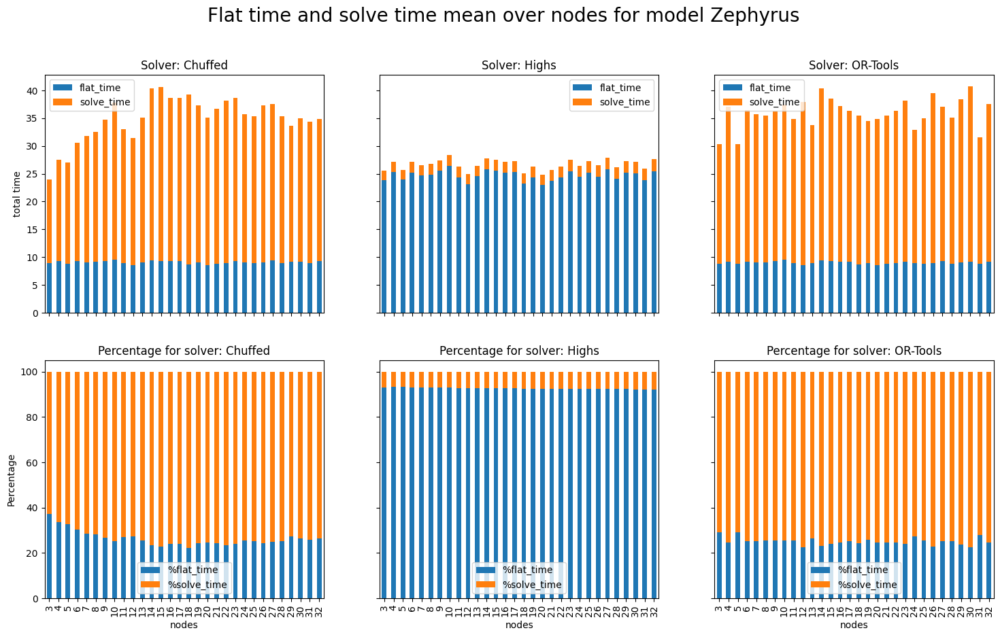

In [102]:
for m in models:
    for over in ["components", "nodes"]:
        fig, axs = plt.subplots(
            nrows=2,
            ncols=len(solvers),
            figsize=(6 * len(solvers), 10),
            sharex=True,
            sharey="row"
        )
        axs_reshaped = axs.reshape(-1)

        for solver, (i, ax) in zip(solvers, enumerate(axs_reshaped)):
            times = (
                df
                .query("solver == @solver")
                .query("model == @m")
                .assign(**{
                    "solve_time" : lambda df : df["solve_time"] - df["flat_time"]
                })
                .groupby(over)
                [["flat_time", "solve_time"]]
                .mean()
            )

            times.plot.bar(
                ax=ax,
                stacked=True,
                title="Solver: " + solver,
            )
            ax.set_ylabel("total time")

            times.assign(**{
                "%flat_time" : lambda df : (df["flat_time"] / (df["flat_time"] + df["solve_time"])) * 100,
                "%solve_time" : lambda df : (df["solve_time"] / (df["flat_time"] + df["solve_time"])) * 100
            }).drop(
                columns=["solve_time", "flat_time"]
            ).plot.bar(
                stacked=True,
                title="Percentage for solver: " + solver,
                ax=axs_reshaped[len(solvers) + i],
            )
            axs_reshaped[len(solvers) + i].set_ylabel("Percentage")

        fig.suptitle("Flat time and solve time mean over " + over + " for model " + m, fontsize=20)
        plt.show()


# Paper images and tables

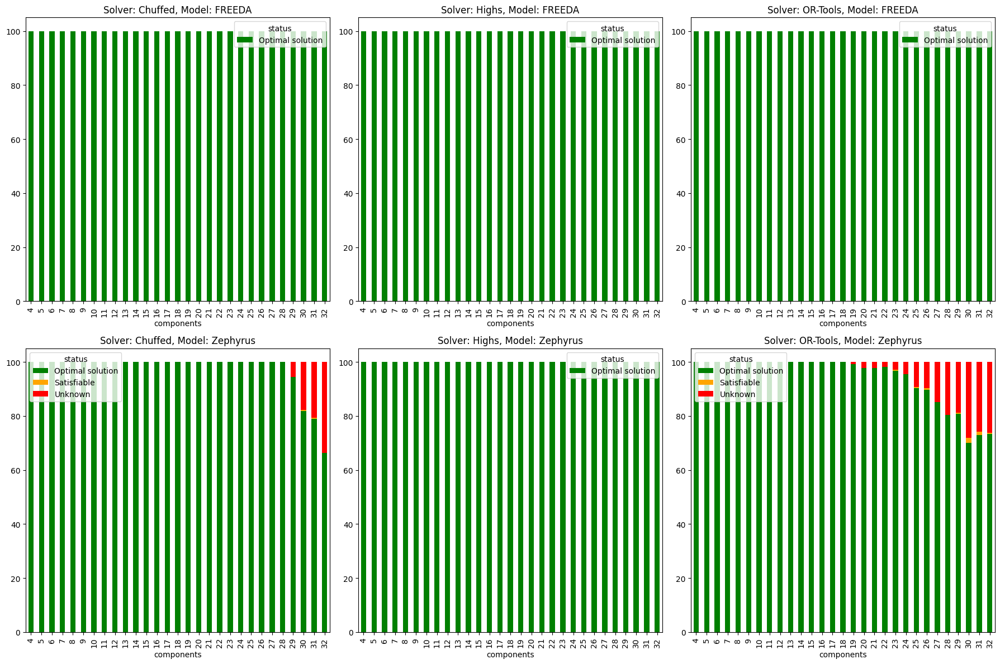

In [103]:
colors = {
    "Optimal solution": "green",
    "Unsatisfiable": "#1f77b4",
    "Unknown": "red",
    "Satisfiable" : "orange"
}
fig, axs = plt.subplots(
    nrows=2,
    ncols=len(solvers),
    figsize=(6 * len(solvers), 12)
)
norm = Normalize(vmin=0, vmax=100)
for model, ax_row in zip(models, axs):
    for solver, ax in zip(solvers, ax_row):
        d = (
            df.query("solver == @solver")
            .query("model == @model")
            [["components", "status"]]
            .groupby("components")
            .value_counts(normalize=True)
            * 100
        ).reset_index().pivot(
            index="components",
            columns="status",
            values="proportion"
        ).fillna(0)

        d.plot.bar(
            color=colors,
            stacked=True,
            ax=ax,
            title="Solver: " + solver + ", Model: " + model
        )

fig.tight_layout()
plt.show()

Text(0, 0.5, 'solve time difference')

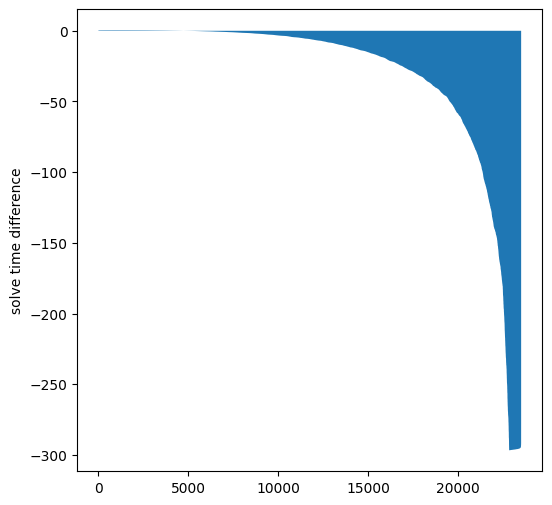

In [104]:
fig, ax = plt.subplots(1, 1, figsize=(6, 6))

area_plot = (
    df.query("model == 'FREEDA'").solve_time.sort_values().reset_index(drop=True)
    -
    df.query("model == 'Zephyrus'").solve_time.sort_values().reset_index(drop=True)
).reset_index()

ax.fill_between(area_plot.index, area_plot.solve_time)
ax.set_xlabel("")
ax.set_ylabel("solve time difference")

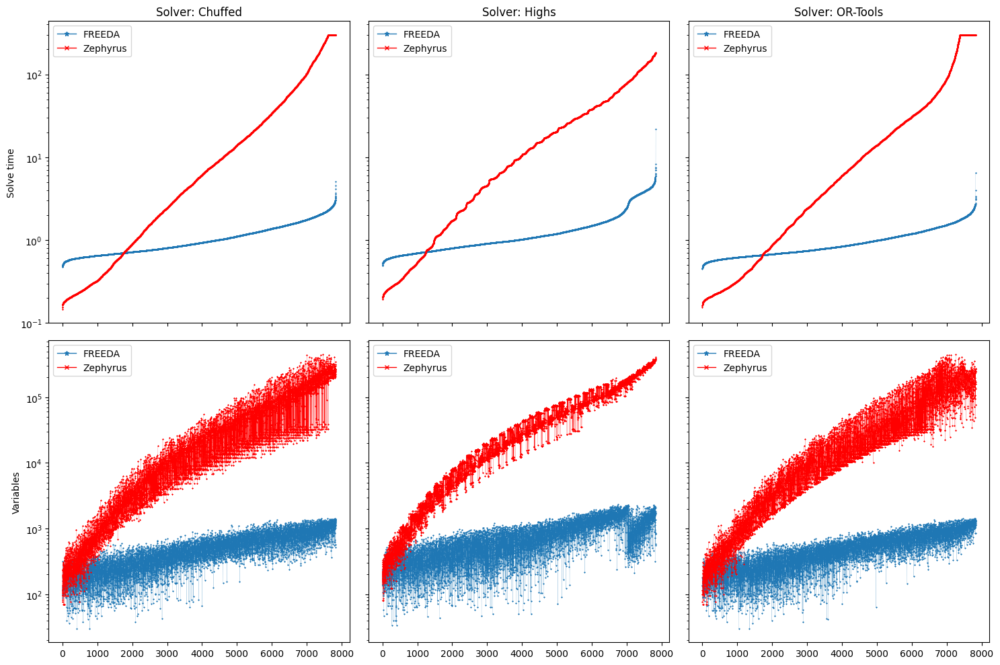

In [105]:
fig, axs = plt.subplots(
    nrows=2,
    ncols=len(solvers),
    sharex=True,
    sharey="row",
    figsize=(5 * len(solvers), 10),
)

for solver, ax in zip(solvers, axs.T):
    for model in models:
        d = (
            df
            .query("solver == @solver")
            .query("model == @model")
            .sort_values("solve_time", ascending=True)
            .reset_index(drop=True)
            .reset_index()
        )
        ax[0].plot(
            d.index,
            d.solve_time,
            marker=marker_model[model],
            c=color_model[model],
            label=model,
            markersize=1,
            linewidth=0.1
        )
        ax[1].plot(
            d.index,
            d.flatzinc_vars,
            marker=marker_model[model],
            c=color_model[model],
            label=model,
            markersize=1,
            linewidth=0.1
        )
        err = d.query("status == 'Error'")
        if len(err) > 0:
            for i, what in zip([0, 1], ["solve_time", "flatzinc_vars"]):
                ax[i].plot(
                    err.index,
                    err[what],
                    marker="o",
                    c="black",
                    label=model,
                    markersize=1,
                )
        ax[0].set_title("Solver: " + solver)
        ax[0].set_yscale('log')
        ax[1].set_yscale('log')
        ax[0].set_xlabel("")
        ax[1].set_xlabel("")
        ax[0].legend(fontsize=10, markerscale=5)
        ax[1].legend(fontsize=10, markerscale=5)
        for i in [0, 1]:
            for legend_line in ax[i].get_legend().get_lines():
                legend_line.set_linewidth(1)

axs[0][0].set_ylabel("Solve time")
axs[1][0].set_ylabel("Variables")
fig.tight_layout()

In [106]:
save_fig(fig, "solve-time-log-zeph")

In [107]:
mean_solve_time = (
    df[["model", "solver", "solve_time"]]
    .groupby(["model", "solver"])
    .aggregate("mean")
    .rename(columns={"solve_time" : "avg all"})
    .map(lambda x : str(round(x, 2)) + "s")
)
mean_solve_time

avg all
model    solver          
FREEDA   Chuffed    1.08s
         Highs      1.35s
         OR-Tools   0.97s
Zephyrus Chuffed   34.94s
         Highs     26.68s
         OR-Tools  36.02s

In [108]:
mean_opt_solve_time = (
    df
    .query("status == 'Optimal solution' or status == 'Unsatisfiable'")
    [["model", "solver", "solve_time"]]
    .groupby(["model", "solver"])
    .aggregate("mean")
    .rename(columns={"solve_time" : "avg solved"})
    .map(lambda x : str(round(x, 2)) + "s")
)
mean_opt_solve_time

avg solved
model    solver             
FREEDA   Chuffed       1.08s
         Highs         1.35s
         OR-Tools      0.97s
Zephyrus Chuffed      27.56s
         Highs        26.68s
         OR-Tools     19.44s

In [109]:
perc = (
    df[["model", "solver", "status"]]
    .groupby(["model", "solver"])
    .aggregate(lambda x : str(round((
        len(x[x.str.contains("Optimal solution") | x.str.contains("Unsatisfiable")]) / len(x)) * 100,
        2)) + "%")
    .rename(columns={"status" : "solved"})
)
perc

solved
model    solver          
FREEDA   Chuffed   100.0%
         Highs     100.0%
         OR-Tools  100.0%
Zephyrus Chuffed   97.29%
         Highs     100.0%
         OR-Tools  94.06%

In [110]:
# Istances where solvers are bugged
df_model_solver = df.assign(**{
    "model_solver": lambda df : df.apply(lambda x : x.model + "_" + x.solver, axis=1)
}).drop(columns=["flavours", "resources", "flat_time", "infra_topology"])

models_solvers = itertools.combinations([m + "_" + s for m, s in itertools.product(models, solvers)], r=2)

scores = []
for model_solver1, model_solver2 in models_solvers:
    to_group = df_model_solver.query("model_solver == @model_solver1 or model_solver == @model_solver2")
    for _, group in to_group.groupby(["components", "nodes", "comps_topology", "test"]):
        scores.append(group.assign(score=borda_count))

In [111]:
scores_df = (
    pd.concat(scores)
    [["model", "solver", "score"]]
    .groupby(["model", "solver"])
    .sum()
    .map(lambda x : round(x, 2))
)
scores_df

score
model    solver            
FREEDA   Chuffed   28080.44
         Highs     25916.50
         OR-Tools  29279.13
Zephyrus Chuffed   12344.73
         Highs      9354.52
         OR-Tools  12474.68

In [112]:
min_max = (
    df[["model", "solve_time", "solver"]]
    .groupby(["model", "solver"])
    .aggregate(["min", "max"])
    .map(lambda x : str(round(x, 2)) + "s")
)
min_max.columns = min_max.columns.droplevel()
min_max

min      max
model    solver                  
FREEDA   Chuffed   0.47s    5.12s
         Highs     0.49s   21.64s
         OR-Tools  0.45s    6.47s
Zephyrus Chuffed   0.15s   300.0s
         Highs     0.19s  183.44s
         OR-Tools  0.15s   300.0s

In [113]:
flat = (
    df[["model", "flat_time", "solver"]]
    .groupby(["model", "solver"])
    .aggregate("mean")
    .rename(columns={"flat_time" : "flat"})
    #.unstack()
    .map(lambda x : str(round(x, 2)) + "s")
)
flat

flat
model    solver          
FREEDA   Chuffed    0.81s
         Highs      1.19s
         OR-Tools    0.8s
Zephyrus Chuffed    9.08s
         Highs     24.71s
         OR-Tools   9.01s

In [114]:
first_last = (
    df
    .query("status == 'Optimal solution' or status == 'Satisfiable'")
    [["model", "objectives", "solver"]]
    .assign(**{
        "first" : lambda df : df.objectives.apply(lambda d : min(float(t) for t in d.keys())),
        "last" : lambda df : df.objectives.apply(lambda d : max(float(t) for t in d.keys()))
    }).drop(columns=["objectives"])
    .groupby(["model", "solver"])
    .aggregate("mean")
    .map(lambda x : str(round(x, 2)) + "s")
)
first_last

first    last
model    solver                  
FREEDA   Chuffed    0.94s   1.08s
         Highs      1.32s   1.32s
         OR-Tools   0.89s   0.94s
Zephyrus Chuffed   19.31s  27.62s
         Highs     26.36s  26.55s
         OR-Tools  17.75s   19.6s

In [115]:
table = pd.concat([
    perc,
    mean_solve_time,
    mean_opt_solve_time,
    min_max,
    first_last,
    flat,
    scores_df,
], axis=1).sort_values("score", ascending=False)
table

solved avg all avg solved    min      max   first    last  \
model    solver                                                                
FREEDA   OR-Tools  100.0%   0.97s      0.97s  0.45s    6.47s   0.89s   0.94s   
         Chuffed   100.0%   1.08s      1.08s  0.47s    5.12s   0.94s   1.08s   
         Highs     100.0%   1.35s      1.35s  0.49s   21.64s   1.32s   1.32s   
Zephyrus OR-Tools  94.06%  36.02s     19.44s  0.15s   300.0s  17.75s   19.6s   
         Chuffed   97.29%  34.94s     27.56s  0.15s   300.0s  19.31s  27.62s   
         Highs     100.0%  26.68s     26.68s  0.19s  183.44s  26.36s  26.55s   

                     flat     score  
model    solver                      
FREEDA   OR-Tools    0.8s  29279.13  
         Chuffed    0.81s  28080.44  
         Highs      1.19s  25916.50  
Zephyrus OR-Tools   9.01s  12474.68  
         Chuffed    9.08s  12344.73  
         Highs     24.71s   9354.52

In [116]:
print(
    table.to_latex(multicolumn=False, escape=True, multirow=False, float_format="%.2f")
)

\begin{tabular}{llllllllllr}
\toprule
 &  & solved & avg all & avg solved & min & max & first & last & flat & score \\
model & solver &  &  &  &  &  &  &  &  &  \\
\midrule
FREEDA & OR-Tools & 100.0\% & 0.97s & 0.97s & 0.45s & 6.47s & 0.89s & 0.94s & 0.8s & 29279.13 \\
 & Chuffed & 100.0\% & 1.08s & 1.08s & 0.47s & 5.12s & 0.94s & 1.08s & 0.81s & 28080.44 \\
 & Highs & 100.0\% & 1.35s & 1.35s & 0.49s & 21.64s & 1.32s & 1.32s & 1.19s & 25916.50 \\
Zephyrus & OR-Tools & 94.06\% & 36.02s & 19.44s & 0.15s & 300.0s & 17.75s & 19.6s & 9.01s & 12474.68 \\
 & Chuffed & 97.29\% & 34.94s & 27.56s & 0.15s & 300.0s & 19.31s & 27.62s & 9.08s & 12344.73 \\
 & Highs & 100.0\% & 26.68s & 26.68s & 0.19s & 183.44s & 26.36s & 26.55s & 24.71s & 9354.52 \\
\bottomrule
\end{tabular}



In [117]:
freeda_slower = []
for _, g in df.groupby(["components", "nodes", "comps_topology", "test", "solver"]):
    freeda = g.query("model == 'FREEDA'")
    zephyrus = g.query("model == 'Zephyrus'")

    if len(freeda) != 1:
        print("MORE THAN ONE FREEDA")
        print(g)
    if len(zephyrus) != 1:
        print("MORE THAN ONE ZEPHYRUS")

    if freeda.solve_time.iloc[0] > zephyrus.solve_time.iloc[0]:
        freeda_slower.append(freeda)

In [118]:
freeda_slower_table = (
    pd.concat(freeda_slower)
    .groupby("solver")
    ["status"]
    .aggregate(**{"status" : "count"})
    .rename(columns={"status" : "amount"})
    .assign(**{"%" : lambda df : df.apply(lambda x : x.amount / (len(combinations) / len(solvers)) * 100 , axis=1)})
)
freeda_slower_table.loc["TOTAL", "%"] = freeda_slower_table.amount.sum() / len(combinations) * 100
freeda_slower_table.loc["TOTAL", "amount"] = freeda_slower_table.amount.sum()
freeda_slower_table

,amount,%
solver,,
Chuffed,1757.0,11.219668
Highs,1291.0,8.243934
OR-Tools,1740.0,11.111111
TOTAL,4788.0,10.191571
